# ICT305 GROUP PROJECT - INTERACTIVE DATA VISUALISATION

In [1]:
### ICT305_Project_IDV.ipynb ###

'''
ICT305: Data Visualisation and Simulation
Group Project
Group Name: Machine Masters
Interactive Data Visualisation
Eren Stannard - 34189185
'''

'\nICT305: Data Visualisation and Simulation\nGroup Project\nGroup Name: Machine Masters\nInteractive Data Visualisation\nEren Stannard - 34189185\n'

In [2]:
# Import libraries

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import plotly.express as px

from CrimeData import getCrimeData

In [3]:
# Load dataset

filename = 'WA Police Force Crime Timeseries'
file_path = 'Datasets'
sheet_name = 'Data'

crimes_df = getCrimeData(filename, file_path = file_path, sheet_name = sheet_name)
crimes_df.head()

,District,Crime,Period,Year,Month,Count,Region,State,Population,Count_Per_100
0,Armadale,Homicide,2007-01-01,2007,1,0,Metropolitan,Western,248231.0,0.000000
1,Armadale,Homicide,2007-02-01,2007,2,0,Metropolitan,Western,248231.0,0.000000
2,Armadale,Homicide,2007-03-01,2007,3,1,Metropolitan,Western,248231.0,0.000403
3,Armadale,Homicide,2007-04-01,2007,4,0,Metropolitan,Western,248231.0,0.000000
4,Armadale,Homicide,2007-05-01,2007,5,0,Metropolitan,Western,248231.0,0.000000


In [4]:
# Function for getting crime counts for a region

def getCrimeCounts(df, scale = 'District', area = None):

    if area:
        df = df[df[scale].str.contains(area.upper())]

    df = df[[scale, 'Crime', 'Count_Per_100']]
    df = df.groupby(by = [scale, 'Crime'], observed = False,
                    as_index = False).sum().sort_values(by = 'Count_Per_100', ascending = False)
    
    return df

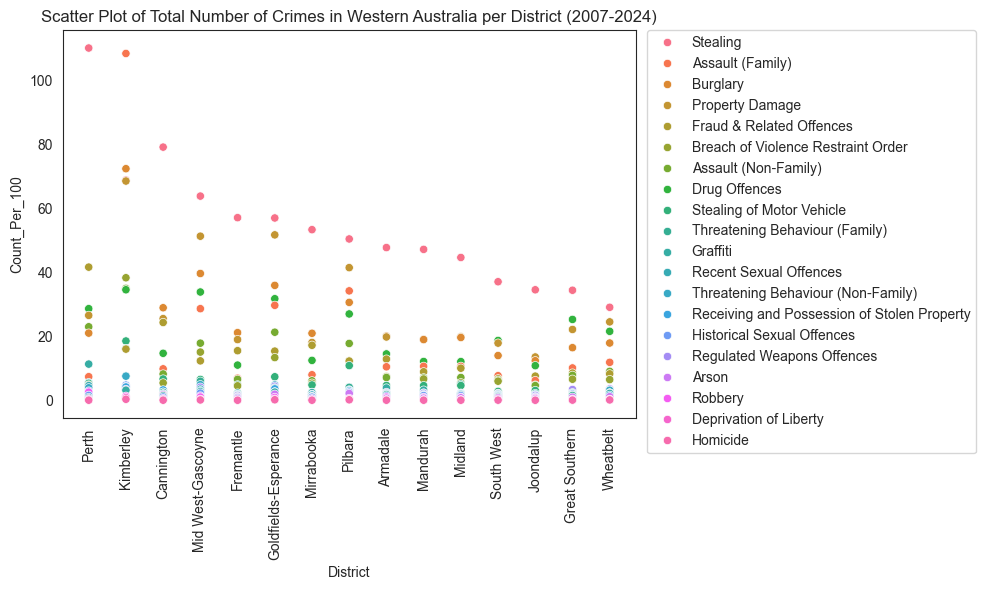

In [5]:
# Generate static 2D scatter plot

plt.figure(figsize = (10, 6))
sns.set_style('white')
ax = sns.scatterplot(data = getCrimeCounts(crimes_df, 'District'), x = 'District', y = 'Count_Per_100', hue = 'Crime')
ax.legend(bbox_to_anchor = (1.02, 1), loc = 'upper left', borderaxespad = 0)
ax.set_xticks(ax.get_xticks())
ax.set_xticklabels(ax.get_xticklabels(), rotation = 90)
ax.set_title('Scatter Plot of Total Number of Crimes in Western Australia per District (2007-2024)')
plt.tight_layout()
plt.savefig('Figures/' + ax.get_title())

In [6]:
# Create scatter plot

fig = px.scatter(
    crimes_df,
    x = 'Count_Per_100',
    y = 'Crime',
    animation_frame = 'Year',
    animation_group = 'Crime',
    color = 'District',
    facet_col = 'District',
    facet_col_wrap = 5,
    facet_row_spacing = 0.03,
    width = 1500,
    height = 1300)

fig.show()

In [7]:
# Create scatter plot

fig = px.scatter(
    crimes_df,
    x = 'Count_Per_100',
    y = 'Crime',
    animation_frame = 'Year',
    animation_group = 'Crime',
    color = 'District',
    width = 1200,
    height = 700,
)

fig.show()

In [8]:
# Create scatter plot

fig = px.scatter(
    crimes_df,
    x = 'Count_Per_100',
    y = 'District',
    animation_frame = 'Year',
    animation_group = 'District',
    color = 'Crime',
    width = 1200,
    height = 700,
)

fig.show()